# longyearbyen_test

In [1]:
%load_ext autoreload
%autoreload 2
#import os
#import sys
#module_path = os.path.abspath(os.path.join('..'))
#if module_path not in sys.path:
#    sys.path.append(module_path)
#import oogeso
from oogeso.io import file_io
import oogeso.plots as plots
from oogeso.utils import create_time_series_data
import oogeso.dto
import matplotlib.pyplot as plt
import IPython.display
#import numpy as np
import pandas as pd
import logging
import pprint
import ipywidgets
import pickle
import plotly.express as px
import pyomo.environ as pyo
from dataclasses import asdict

logging.basicConfig()
logger = logging.getLogger()
logger.setLevel('INFO') #INFO
#print("Using Oogeso version {}".format(oogeso.__version__))

## Read input data

In [2]:
first = pd.read_csv('../tests/test_data/LYR_load.csv')
second = pd.read_csv('../tests/test_data/cap_factors_1hr_airport.csv')
third = pd.read_csv('../tests/test_data/LYR_solar_supply.csv')
assert isinstance(first, pd.DataFrame)

merged = pd.merge(first, second, how='left', on='timestamp')
merged = pd.merge(merged, third, how='left', on='timestamp')
merged.fillna(0,inplace=True)
#merged.to_csv('../tests/test_data/profiles_merged.csv', index=False)

In [3]:
merged.set_index(merged["timestamp"], inplace=True)
#merged

In [4]:
case="_diesel_only"
#case="_diesel_battery"
#case="_ir_offshore_pv"
#case="_ir_offshore_pv_diesel"
#case="_br_offshore_pv_diesel"
#case="_br_offshore_pv_diesel_2018"
timerange=[0,24*365] #one year (with 1 hour timestep)
#timerange=[0,24*7*50] #50 weeks (with 1 hour timestep)
#timerange=[0,24*7] #one week (with 1 hour timestep)

outpath = "result/"
plots.plotter="plotly"

data = file_io.read_data_from_yaml("../tests/test_data/longyearbyen_test.yaml")
data.parameters.co2_tax = 2 # NOK/kgCO2 Political goal towards 2030

incl_battery=False
incl_heatpump=False
incl_wind=False
incl_pv=False
incl_hydrogen=False
incl_diesel=False

if case=="_diesel_only":
    # Combine profiles
    load = pd.read_csv('../tests/test_data/LYR_load.csv')
    load.to_csv('../tests/test_data/profiles'+case+'.csv', index=False)
    incl_diesel=True
    for carrier in data.carriers:
        if carrier.id == "el":
            carrier.el_reserve_margin = 0

if case=="_diesel_battery":
    # Combine profiles
    load = pd.read_csv('../tests/test_data/LYR_load.csv')
    load.to_csv('../tests/test_data/profiles'+case+'.csv', index=False)
    incl_battery=True
    incl_diesel=True
    for carrier in data.carriers:
        if carrier.id == "el":
            carrier.el_reserve_margin = 0

if case=="_ir_offshore_pv":
    # Combine profiles
    first = pd.read_csv('../tests/test_data/LYR_load.csv')
    second = pd.read_csv('../tests/test_data/cap_factors_1hr_ir.csv')
    third = pd.read_csv('../tests/test_data/LYR_solar_supply.csv')
    merged = pd.merge(first, second, how='left', on='timestamp')
    merged = pd.merge(merged, third, how='left', on='timestamp')
    merged.to_csv('../tests/test_data/profiles'+case+'.csv', index=False)
    wind_P_max=3.45*5 # MW, 5 Vestas V105 turbines
    wind_profile="V105" # Offshore wind profile name with Isfjord Radio data
    pv_P_max=25 # MWp, Sun on all roofs
    incl_battery=True
    incl_heatpump=True
    incl_wind=True
    incl_pv=True
    incl_hydrogen=True

elif case=="_ir_offshore_pv_diesel":
    # Combine profiles
    first = pd.read_csv('../tests/test_data/LYR_load.csv')
    second = pd.read_csv('../tests/test_data/cap_factors_1hr_ir.csv')
    third = pd.read_csv('../tests/test_data/LYR_solar_supply.csv')
    merged = pd.merge(first, second, how='left', on='timestamp')
    merged = pd.merge(merged, third, how='left', on='timestamp')
    merged.to_csv('../tests/test_data/profiles'+case+'.csv', index=False)
    wind_P_max=3.45*5 # MW, 5 Vestas V105 turbines
    wind_profile="V105" # Offshore wind profile name with Isfjord Radio data
    pv_P_max=25 # MWp, Sun on all roofs
    incl_battery=True
    incl_heatpump=True
    incl_wind=True
    incl_pv=True
    incl_hydrogen=True
    incl_diesel=True

elif case=="_br_offshore_pv_diesel_2018":
    # Combine profiles
    first = pd.read_csv('../tests/test_data/LYR_load.csv')
    second = pd.read_csv('../tests/test_data/cap_factors_1hr_br_log.csv')
    third = pd.read_csv('../tests/test_data/LYR_solar_supply.csv')
    merged = pd.merge(first, second, how='left', on='timestamp')
    merged = pd.merge(merged, third, how='left', on='timestamp')
    merged.set_index(merged["timestamp"], inplace=True)
    merged = merged['2018-01-01':]
    merged.to_csv('../tests/test_data/profiles'+case+'.csv', index=False)
    timerange = [0,min(24*365,len(merged)-data.parameters.planning_horizon)]
    wind_P_max=3.45*10 # MW, 10 Vestas V105 turbines
    wind_profile="V105" # wind profile name with Breinosa data
    pv_P_max=25 # MWp, Sun on all roofs
    incl_battery=True
    incl_heatpump=True
    incl_wind=True
    incl_pv=True
    incl_hydrogen=True
    incl_diesel=True

# Create profiles
timeseries = file_io.read_profiles_from_csv(
    filename_forecasts="../tests/test_data/profiles"+case+".csv",
    dayfirst = False)
profiles = create_time_series_data(
    df_forecast=timeseries["forecast"],
    df_nowcast=timeseries["forecast"],
    time_start=None,time_end=None,
    timestep_minutes=60,
    resample_method="linear")
data.profiles = profiles

winddevices = ["wind", "wind_farm", "el_wf_ps"]
pvdevices = ["pv"]
batterydevices = ["el_storage"]
powersupplydevices = ["powersupply", "el_ps_load", "heat_ps_load"]
heatpumpdevices = ["heatpump", "el_ps_hp", "heat_hp_load"]
hydrogendevices = ['electrolyser','fuelcell','h2_storage','el_ps_h2','heat_h2_load']
dieselgenerators = ['backup_east_1','backup_east_2','backup_east_3','backup_west_1','backup_west_2','backup_west_3']
dieselheaters = ['diesel_boiler_1','diesel_boiler_2','boiler_houses']
dieseldevices = dieselgenerators + dieselheaters + ['diesel_source', 'el_diesel_load', 'heat_diesel_load', 'diesel_backup']
for dev in data.devices:
    if dev.id in winddevices:
        dev.include = incl_wind
        if incl_wind:
            dev.flow_max = wind_P_max
            dev.flow_min = dev.flow_max
            dev.profile = wind_profile
    if dev.id in pvdevices:
        dev.include = incl_pv
        if incl_pv:
            dev.flow_max = pv_P_max
            dev.flow_min = dev.flow_max
    if dev.id in batterydevices:
        dev.include = incl_battery
    if dev.id in hydrogendevices:
        dev.include = incl_hydrogen
    if dev.id in heatpumpdevices:
        dev.include = incl_heatpump
    if dev.id in dieseldevices:
        dev.include = incl_diesel
for edge in data.edges:
    if edge.id in winddevices:
        edge.include = incl_wind
    if edge.id in powersupplydevices:
        edge.include = incl_wind or incl_battery or incl_pv or incl_heatpump or incl_hydrogen
    if edge.id in heatpumpdevices:
        edge.include = incl_heatpump
    if edge.id in hydrogendevices:
        edge.include = incl_hydrogen
    if edge.id in dieseldevices:
        edge.include = incl_diesel
for node in data.nodes:
    if node.id in winddevices:
        node.include = incl_wind
    if node.id in powersupplydevices:
        node.include = incl_wind or incl_pv or incl_battery or incl_heatpump or incl_hydrogen
    if node.id in heatpumpdevices:
        node.include = incl_heatpump
    if node.id in hydrogendevices:
        node.include = incl_hydrogen
    if node.id in dieseldevices:
        node.include = incl_diesel

simulator = oogeso.Simulator(data)

In [5]:
for dev in data.devices:
    #if dev.id=='el_load':
    print(dev)

id='wind' node_id='wind_farm' name='wind_farm' include=False profile=None flow_min=1.0 flow_max=1.0 max_ramp_down=None max_ramp_up=None start_stop=None reserve_factor=1 op_cost=0.003 penalty_function=None model=<ModelType.SOURCE_EL: 'sourceel'> co2em=0.0
id='pv' node_id='powersupply' name='pv' include=False profile=None flow_min=1.0 flow_max=1.0 max_ramp_down=None max_ramp_up=None start_stop=None reserve_factor=1 op_cost=0.002 penalty_function=None model=<ModelType.SOURCE_EL: 'sourceel'> co2em=0.0
id='loadshed' node_id='powersupply' name='Loadshedding (dummy)' include=False profile=None flow_min=None flow_max=1000.0 max_ramp_down=None max_ramp_up=None start_stop=None reserve_factor=0.0 op_cost=10.0 penalty_function=None model=<ModelType.SOURCE_EL: 'sourceel'> co2em=0.0
id='el_load' node_id='load' name='general el load' include=True profile='el_load' flow_min=1.0 flow_max=1.0 max_ramp_down=None max_ramp_up=None start_stop=None reserve_factor=0.0 op_cost=None penalty_function=None model=

In [6]:
# Test solve:
simulator.optimiser.solve(solver="gurobi")

{'Problem': [{'Name': 'x86415', 'Lower bound': 1.3751417310052894, 'Upper bound': 1.3751417310052898, 'Number of objectives': 1, 'Number of constraints': 26857, 'Number of variables': 18481, 'Number of binary variables': 8640, 'Number of integer variables': 8640, 'Number of continuous variables': 9841, 'Number of nonzeros': 61117, 'Sense': 'minimize'}], 'Solver': [{'Status': 'ok', 'Return code': '0', 'Message': 'Model was solved to optimality (subject to tolerances), and an optimal solution is available.', 'Termination condition': 'optimal', 'Termination message': 'Model was solved to optimality (subject to tolerances), and an optimal solution is available.', 'Wall time': '0.1874542236328125', 'Error rc': 0, 'Time': 1.0128602981567383}], 'Solution': [OrderedDict([('number of solutions', 0), ('number of solutions displayed', 0)])]}

In [7]:
#simulator.optimiser.constr_diesel_source_flowMin.pprint()

In [8]:
simulator.optimiser.paramDeviceEnergyInitially.pprint()

paramDeviceEnergyInitially : Size=14, Index=setDevice, Domain=Reals, Default=None, Mutable=True
    Key             : Value
      backup_east_1 :     0
      backup_east_2 :     0
      backup_east_3 :     0
      backup_west_1 :     0
      backup_west_2 :     0
      backup_west_3 :     0
      boiler_houses :     0
    diesel_boiler_1 :     0
    diesel_boiler_2 :     0
      diesel_source :     0
            el_dump :     0
            el_load :     0
          heat_dump :     0
          heat_load :     0


In [9]:
simulator.optimiser.dual.pprint()

dual : Direction=Suffix.IMPORT, Datatype=Suffix.FLOAT
    Key : Value


In [10]:
simulator.optimiser.paramProfiles.pprint() # all 1 before update, from profile after
simulator.optimiser.paramDeviceIsOnInitially.pprint() # all 1 before and after update
simulator.optimiser.paramDevicePrepTimestepsInitially.pprint() # all 0 before and after update
simulator.optimiser.paramDevicePowerInitially.pprint() # unchanged before/after

paramProfiles : Size=480, Index=paramProfiles_index, Domain=Reals, Default=None, Mutable=True
    Key                : Value
        ('el_load', 0) :     1
        ('el_load', 1) :     1
        ('el_load', 2) :     1
        ('el_load', 3) :     1
        ('el_load', 4) :     1
        ('el_load', 5) :     1
        ('el_load', 6) :     1
        ('el_load', 7) :     1
        ('el_load', 8) :     1
        ('el_load', 9) :     1
       ('el_load', 10) :     1
       ('el_load', 11) :     1
       ('el_load', 12) :     1
       ('el_load', 13) :     1
       ('el_load', 14) :     1
       ('el_load', 15) :     1
       ('el_load', 16) :     1
       ('el_load', 17) :     1
       ('el_load', 18) :     1
       ('el_load', 19) :     1
       ('el_load', 20) :     1
       ('el_load', 21) :     1
       ('el_load', 22) :     1
       ('el_load', 23) :     1
       ('el_load', 24) :     1
       ('el_load', 25) :     1
       ('el_load', 26) :     1
       ('el_load', 27) :     1
       

### Inspect input data

In [11]:
@ipywidgets.interact(datagroup=['','devices','nodes','edges','carriers','parameters'])
def showdata(datagroup):
    pprint.pprint(data.dict()[datagroup],indent=1) if datagroup!='' else print('')

interactive(children=(Dropdown(description='datagroup', options=('', 'devices', 'nodes', 'edges', 'carriers', …

In [12]:
yy=['']+list(simulator.optimiser.component_objects(oogeso.optimiser.pyo.Constraint, active=True))
@ipywidgets.interact(constraint=yy)
def showdata(constraint):
    pprint.pprint(constraint.pprint(),width=1) if constraint!='' else print('')

interactive(children=(Dropdown(description='constraint', options=('', <pyomo.core.base.constraint.IndexedConst…

In [13]:
for e in data.edges: print(e.id,e.bidirectional)

el_wf_ps True
el_ps_load True
heat_h2_load True
el_ps_h2 True
el_ps_hp True
heat_hp_load True
el_diesel_load True
heat_diesel_load True


0 2016


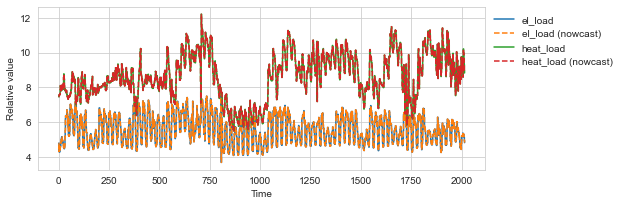

In [14]:
import matplotlib.dates as mdates
plt.figure(figsize=(8,3))
ax=plt.gca()
#day 6, hour 22: 6*24*12 + 22*12 = 
#tstart=7*24*12
#tlen=12*12
#xvalues = pd.date_range(start="00:00:00",freq="5min",periods=tlen)
#myFmt = mdates.DateFormatter('%H:%M')
#ax.xaxis.set_major_formatter(myFmt)
tstart=0
tlen=7*24*12
xvalues=range(tstart,tstart+tlen)
print(tstart,tlen)
for pr in profiles:
    if pr.id in ["curve_const","waterinj","h2target"]: continue
    color = next(ax._get_lines.prop_cycler)['color']
    plt.step(xvalues,pr.data[tstart:(tstart+tlen)],label=pr.id,color=color,where="post")
    if pr.data_nowcast is not None:
        color = next(ax._get_lines.prop_cycler)['color']
        plt.step(xvalues,pr.data_nowcast[tstart:(tstart+tlen)],"--",
                 label="{} (nowcast)".format(pr.id),color=color,where="post")        
plt.legend(loc="upper left",bbox_to_anchor=(1,1),frameon=False)
plt.xlabel("Time")
plt.ylabel("Relative value")
plt.savefig(outpath+"timerseries_ts{}_{}.pdf".format(tstart,case),dpi=300,bbox_inches="tight")

In [15]:
outpath

'result/'

In [16]:
# View profiles (entire available time windows)
scale=300/96 # ratio print vs screen dpi
fig=plots.plot_profiles(profiles,filename=None)
#fig.update_layout(template="plotly_white",autosize=False,width=600,height=200,margin=dict(l=0,r=0,t=0,b=0))
fig.show()
#300 dpi and 4 inch: 1200 pixels
#fig.write_image(outpath+"profiles.pdf",width=600,height=200,scale=scale)

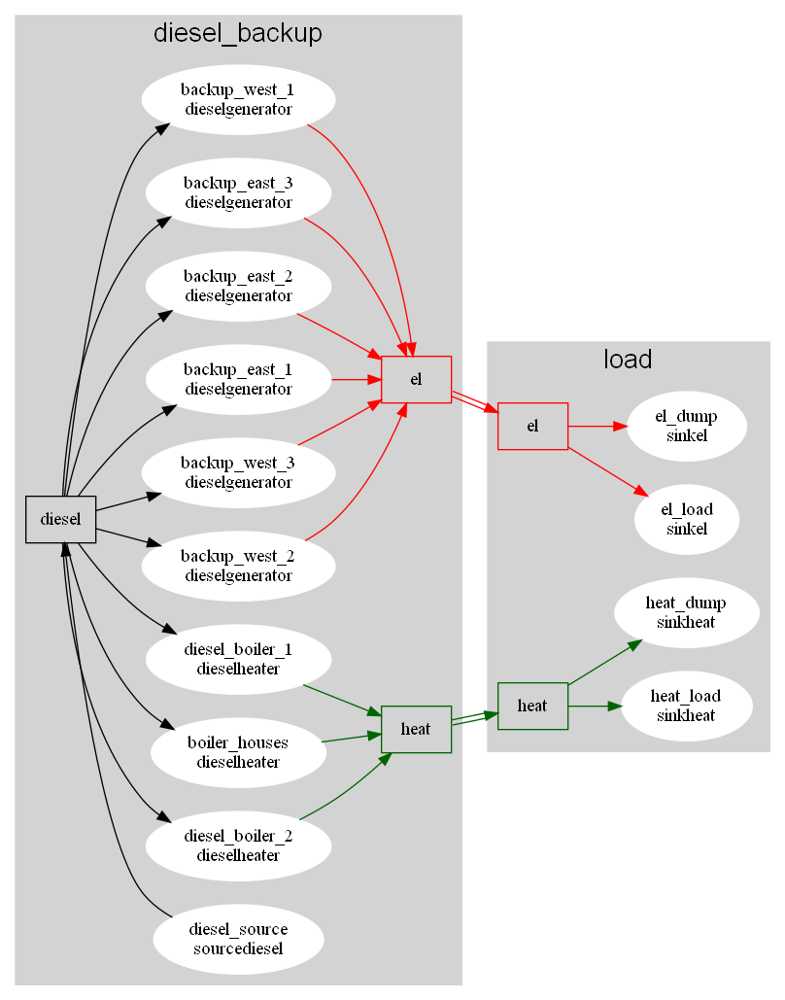

In [17]:
# View energy system
dotG=plots.plot_network(simulator,timestep=None,filename=None,rank_direction="LR",hide_edgelabel=True,only_carrier=None,fontsize=20,fontname = "helvetica",)
IPython.display.Image(dotG.create_png(prog="dot")) #scales automatically to page width
#dotG.write_pdf(path=outpath+"diagram0_{}.pdf".format(case))

### Some checks on input data

In [18]:
if incl_heatpump:
    print(simulator.optimiser.all_edges['heat_hp_load'].edge_data)

## Solve

If the problem is infeasible, try 
* relaxing pressure deviation limits (generic value and per-node value)
* add a high cost emergency generator (that could represent load shedding) to ensure energy balance can be satisfied
* make sure excess heat/water/gas has a place to go


In [19]:
if incl_wind:
    dev_d=simulator.optimiser.all_devices["wind"].dev_data
if incl_wind or incl_pv or incl_battery or incl_heatpump or incl_hydrogen:
    node_d=simulator.optimiser.all_nodes["powersupply"].node_data

In [20]:
#simulator.optimiser.write("testplatform.mps")
sim_result = simulator.run_simulation(solver="gurobi",time_range=timerange,write_yaml=False,time_limit=15)
print("Mean CO2 emission rate      = {:.1f} kgCO2/s".format(sim_result.co2_rate.mean()))
print("Mean CO2 emission intensity = {:.1f} kgCO2/Sm3oe".format(sim_result.co2_intensity.mean()))

100%|██████████| 365/365 [36:54<00:00,  6.07s/it]

Mean CO2 emission rate      = 1.5 kgCO2/s
Mean CO2 emission intensity = nan kgCO2/Sm3oe


In [21]:
#simulator.optimiser.updateOptimisationModel(timestep=0,profiles=data.profiles,first=True)
simulator.optimiser.write("test.mps",io_options = {"symbolic_solver_labels":True})

('test.mps', 2550640180768)

In [22]:
# Remove negligible dump values (Less than 1 W)
sim_result.device_flow["el_dump"]["el"]["in"][abs(sim_result.device_flow["el_dump"]["el"]["in"]) < 10**(-6)] = 0
sim_result.device_flow["heat_dump"]["heat"]["in"][abs(sim_result.device_flow["heat_dump"]["heat"]["in"]) < 10**(-6)] = 0
sim_result.op_cost_per_dev["el_dump"][sim_result.device_flow["el_dump"]["el"]["in"] == 0] = 0
sim_result.op_cost_per_dev["heat_dump"][sim_result.device_flow["heat_dump"]["el"]["in"] == 0] = 0

In [23]:
#simulator.optimiser.constrO_elReserveMargin[6].pprint()
#pyo.value(simulator.optimiser.varEdgeFlow["el_ps_load",10])

In [24]:
# print(pyo.value(simulator.optimiser.paramProfiles["V105",1]),
#     pyo.value(simulator.optimiser.varDeviceIsOn["wind",6]),
#     pyo.value(simulator.optimiser.varDeviceIsOn["electrolyser",6]),
#     pyo.value(simulator.optimiser.varDeviceIsOn["heatpump",6]),
# )

## Save/Load simulation results
By saving to pickle file, it easy to later open and analyse the results without having to re-run the simulation

In [25]:
pickle_save='{}case{}.pkl'.format(outpath,case)
# Save (pickle) - for later opening and analysis
dumpdata={"data":data,"result":sim_result}
with open(pickle_save, mode='wb') as file:
   pickle.dump(dumpdata, file)
print("Results were saved to {}".format(pickle_save))

Results were saved to result/case_diesel_only.pkl


In [26]:
# Open previously saved object (including simulation results)
#with open(pickle_save, mode='rb') as file:
#   sim_data = cloudpickle.load(file)
#data=sim_data["data"]
#sim_result=sim_data["result"]

## Analyse results

In [27]:
import oogeso.result_analysis
kpi = oogeso.result_analysis.compute_kpis(sim_result, sim_data=data, fuel_carrier = "diesel")#, windturbines=['wind'])
kpi = pd.DataFrame.from_dict(kpi,orient="index",columns=[case])
kpi

,_diesel_only
hours_simulated,8.760000e+03
kgCO2_per_year,4.598203e+07
kgCO2_per_Sm3oe,NaN
fuel_sm3_per_year,1.741744e+04
elconsumption_mwh_per_year,4.233405e+04
elconsumption_avg_mw,4.832654e+00
gt_starts_per_year,1.761000e+03
gt_stops_per_year,1.756000e+03
gt_hoursrunning_per_year,3.809100e+04
wind_output_mwh_per_year,0.000000e+00


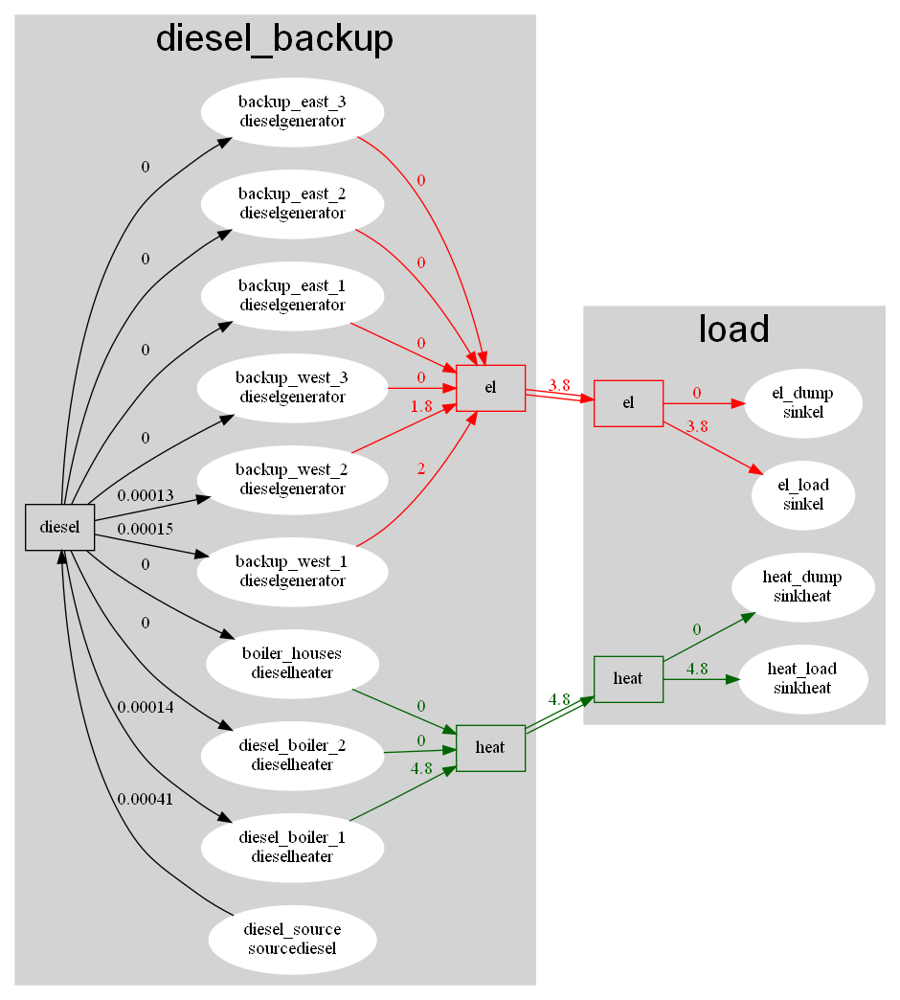

In [28]:
tstep=5592
gCombined = plots.plot_network(simulator=simulator,timestep=tstep,numberformat="{:.3g}",
                              filename=None,only_carrier=None,fontsize=30,fontname = "helvetica",
                              hide_losses=True)
IPython.display.Image(gCombined.create_png())
#gCombined.write_png(path=outpath+"diagram_{}.pdf".format(case),f="pdf")
#gCombined.write_pdf(path=outpath+"diagram_{}.pdf".format(case))

In [29]:
print(sim_result.device_flow.el_load.el["in"].to_string())

time
0       4.81000
1       4.33000
2       4.54000
3       4.69000
4       4.30000
5       4.48000
6       4.53000
7       4.54000
8       4.62000
9       4.68000
10      4.80000
11      4.87000
12      4.99000
13      5.06000
14      5.15000
15      5.17000
16      5.17000
17      5.05000
18      4.97000
19      4.94000
20      4.90000
21      4.83000
22      4.80000
23      4.69000
24      4.56000
25      4.53000
26      4.55000
27      4.49000
28      4.54000
29      4.61000
30      4.73000
31      5.17000
32      5.51000
33      6.20000
34      6.38000
35      6.32000
36      6.30000
37      6.33000
38      6.34000
39      6.44000
40      6.72000
41      6.64000
42      6.62000
43      6.47000
44      5.82000
45      6.34000
46      6.15000
47      5.70000
48      5.32000
49      5.23000
50      5.21000
51      5.22000
52      5.24000
53      5.29000
54      5.51000
55      5.95000
56      6.80000
57      7.01000
58      7.04000
59      6.93400
60      6.80000
61      6.95000
62 

In [30]:
print(sim_result.device_flow.heat_dump.to_string())

carrier   terminal  time
diesel    in        0       0.0
                    1       0.0
                    2       0.0
                    3       0.0
                    4       0.0
                    5       0.0
                    6       0.0
                    7       0.0
                    8       0.0
                    9       0.0
                    10      0.0
                    11      0.0
                    12      0.0
                    13      0.0
                    14      0.0
                    15      0.0
                    16      0.0
                    17      0.0
                    18      0.0
                    19      0.0
                    20      0.0
                    21      0.0
                    22      0.0
                    23      0.0
                    24      0.0
                    25      0.0
                    26      0.0
                    27      0.0
                    28      0.0
                    29      0.0
               

In [31]:
#simulator.optimiser.all_nodes['wells'].devices_serial
#sim_result.dfEdgeFlow.unstack("edge").loc[151]
#simulator.optimiser.constrN_wells_energybalance["gas","out",0].pprint()
#print(pyo.value(simulator.optimiser.varDeviceFlow["wellL1","gas","out",0]))
#print(pyo.value(simulator.optimiser.varDeviceFlow["wellL2","gas","out",0]))
#print(pyo.value(simulator.optimiser.varEdgeFlow["cL2g",0]))
#print(pyo.value(simulator.optimiser.varEdgeLoss21["cL2g",0]))

In [32]:
combine = None
if incl_diesel: combine = [["diesel_generators"],[dieselgenerators]]

fig2=plots.plot_sum_power_mix(sim_result,simulator.optimiser,carrier="el",filename=None,devs_combine=combine,exclude_zero=True)#,devs_shareload=dieselgenerators, exclude_zero=True)#['Gen1','Gen2','Gen3'])
#fig2.update_layout(autosize=False,width=800,height=500,margin=dict(l=0,r=0,t=0,b=0))
#fig2.write_image("{}/elpowermix_{}.png".format(outpath,case))
#fig2.set_size_inches(6,4)
plt.suptitle("")
fig2.show()
plt.savefig("result/poweroutputel_{}x.pdf".format(case),dpi=300,bbox_inches="tight")

<Figure size 432x288 with 0 Axes>

In [33]:
combine = None
if incl_diesel: combine = [["diesel_boilers"],[dieselheaters]]

fig2=plots.plot_sum_power_mix(sim_result,simulator.optimiser,carrier="heat",filename=None,devs_combine=combine,exclude_zero=True)#,devs_shareload=dieselgenerators, exclude_zero=True)#['Gen1','Gen2','Gen3'])
#fig2.update_layout(autosize=False,width=800,height=500,margin=dict(l=0,r=0,t=0,b=0))
#fig2.write_image("{}/elpowermix_{}.png".format(outpath,case))
#fig2.set_size_inches(6,4)
plt.suptitle("")
fig2.show()
plt.savefig("result/poweroutputheat_{}x.pdf".format(case),dpi=300,bbox_inches="tight")

<Figure size 432x288 with 0 Axes>

In [34]:
plots.plotter="plotly"
gts = [d for d,d_obj in simulator.optimiser.all_devices.items() if d_obj.dev_data.model in ["dieselgenerator","source_el"]]
fig=plots.plot_device_profile(sim_result,simulator.optimiser,devs=gts,filename=None,include_on_off=True, include_prep=False,devs_shareload=None)
fig.update_layout(autosize=False,width=1000,height=400,margin=dict(l=0,r=0,t=30,b=0),template="plotly_white",
                 title="Power supply and on/off status (case: {})".format(case))
fig.show()

,el,heat
device,,
backup_east_1,0.000000,0.000000
backup_east_2,0.000000,0.000000
backup_east_3,0.000000,0.000000
backup_west_1,0.000000,0.000000
backup_west_2,0.000000,0.000000
backup_west_3,0.000000,0.000000
boiler_houses,0.000000,0.000000
diesel_boiler_1,0.000000,0.000000
diesel_boiler_2,0.000000,0.000000


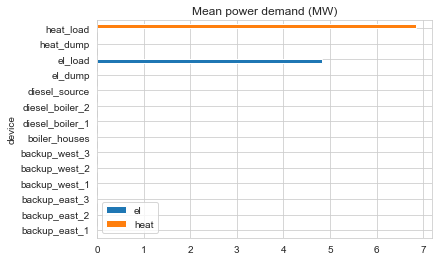

In [35]:
mean_el_demand = sim_result.device_flow.unstack('carrier')['el'].unstack('terminal')['in'].dropna().unstack().T.mean()
mean_heat_demand = sim_result.device_flow.unstack('carrier')['heat'].unstack('terminal')['in'].dropna().unstack().T.mean()
energydemand = pd.concat({'el':mean_el_demand,'heat':mean_heat_demand},axis=1)
#energydemand.drop('heatdump',inplace=True)
energydemand.plot.barh(title="Mean power demand (MW)")
energydemand

In [36]:
energydemand.sum()

el      4.832654
heat    6.844884
dtype: float64

In [37]:
mean_flows=sim_result.device_flow.unstack(["carrier","device","terminal"]).mean().unstack(["carrier","terminal"])
print("Mean flows:\n",mean_flows.sum())
print("Mean flow per device:")
mean_flows

Mean flows:
 carrier   terminal
diesel    in          0.000552
          out         0.000552
el        in          4.832654
          out         4.832654
heat      in          6.844884
          out         6.844884
hydrogen  in          0.000000
          out         0.000000
dtype: float64
Mean flow per device:


carrier            diesel                  el                heat            \
terminal               in       out        in       out        in       out   
device                                                                        
backup_east_1    0.000100  0.000000  0.000000  1.363701  0.000000  0.000000   
backup_east_2    0.000090  0.000000  0.000000  1.213763  0.000000  0.000000   
backup_east_3    0.000063  0.000000  0.000000  0.830917  0.000000  0.000000   
backup_west_1    0.000060  0.000000  0.000000  0.821158  0.000000  0.000000   
backup_west_2    0.000028  0.000000  0.000000  0.387769  0.000000  0.000000   
backup_west_3    0.000016  0.000000  0.000000  0.215345  0.000000  0.000000   
boiler_houses    0.000000  0.000000  0.000000  0.000000  0.000000  0.000000   
diesel_boiler_1  0.000181  0.000000  0.000000  0.000000  0.000000  6.359804   
diesel_boiler_2  0.000014  0.000000  0.000000  0.000000  0.000000  0.485080   
diesel_source    0.000000  0.000552  0.000000  0.000000  0.000000  0.000000   
el_dump          0.000000  0.000000  0.000000  0.000000  0.000000  0.000000   
el_load          0.000000  0.000000  4.832654  0.000000  0.000000  0.000000   
heat_dump        0.000000  0.000000  0.000000  0.000000  0.000000  0.000000   
heat_load        0.000000  0.000000  0.000000  0.000000  6.844884  0.000000   

carrier         hydrogen       
terminal              in  out  
device                         
backup_east_1        0.0  0.0  
backup_east_2        0.0  0.0  
backup_east_3        0.0  0.0  
backup_west_1        0.0  0.0  
backup_west_2        0.0  0.0  
backup_west_3        0.0  0.0  
boiler_houses        0.0  0.0  
diesel_boiler_1      0.0  0.0  
diesel_boiler_2      0.0  0.0  
diesel_source        0.0  0.0  
el_dump              0.0  0.0  
el_load              0.0  0.0  
heat_dump            0.0  0.0  
heat_load            0.0  0.0

In [62]:
plots.plotter="plotly"
gts = [d for d,d_obj in simulator.optimiser.all_devices.items() if d_obj.dev_data.model in ["sourceel"]]
fig=plots.plot_device_profile(sim_result,simulator.optimiser,devs=gts,filename=None,include_on_off=False,include_prep=False,devs_shareload=None)
#fig.update_layout(autosize=False,width=700,height=300,margin=dict(l=0,r=0,t=30,b=0),template="plotly_white")
fig.show()
#300 dpi and 4 inch: 1200 pixels
scale=300/96 # ratio print vs screen dpi
#fig.write_image(outpath+"powersupply.pdf",width=700,height=300,scale=scale)

In [39]:
df = sim_result.device_flow.unstack(["carrier", "terminal"])[("el", "out")].unstack("device")
df.index

Int64Index([   0,    1,    2,    3,    4,    5,    6,    7,    8,    9,
            ...
            8750, 8751, 8752, 8753, 8754, 8755, 8756, 8757, 8758, 8759],
           dtype='int64', name='time', length=8760)

In [40]:
import plotly
fig = plotly.subplots.make_subplots(rows=1, cols=1, shared_xaxes=True)
if incl_wind:
    fig.add_scatter(
                    x=df.index,
                    y=df["wind"],
                    line_shape="hv",
                    name="wind",
                    #line=dict(color=colour[k]),
                    stackgroup="P",
                    legendgroup="wind",
                    row=1,
                    col=1,
                )

In [41]:
dfStartopt = pd.DataFrame()
inst=simulator.optimiser
for t in inst.setHorizon: 
    if incl_wind: dfStartopt.loc[t,'start']=inst.varDeviceStarting['wind',t].value
    if incl_heatpump: dfStartopt.loc[t,'prep']=inst.varDeviceIsPrep['heatpump',t].value
    if incl_hydrogen: 
        dfStartopt.loc[t,'on']=inst.varDeviceIsOn['electrolyser',t].value
        dfStartopt.loc[t,'stop']=inst.varDeviceStopping['fuelcell',t].value
dfStartopt.head()

""


In [42]:
if incl_wind:
    fig=plots.plot_device_profile(sim_result,simulator.optimiser,devs=['wind'],filename=None,include_forecasts=True)
    fig.update_layout(autosize=False,width=800,height=300,margin=dict(l=0,r=0,t=0,b=0))

In [43]:
"""
df=sim_result.device_flow.unstack([0,1,2])[[('ex_g','gas','in'),('ex_o','oil','in')]]
df.columns=['gas','oil']
df=df.reset_index()
df["gas"]=df["gas"]/1000 # convert to oil equivalents
df = df.melt(var_name="Product",value_name="Volume rate (Sm3oe/s)",id_vars=('time'))
px.line(df,x="time",y="Volume rate (Sm3oe/s)",color="Product",title="Oil/gas export volumes (Sm3oe/s)").show()

plots.plot_export_revenue(sim_result)
"""

'\ndf=sim_result.device_flow.unstack([0,1,2])[[(\'ex_g\',\'gas\',\'in\'),(\'ex_o\',\'oil\',\'in\')]]\ndf.columns=[\'gas\',\'oil\']\ndf=df.reset_index()\ndf["gas"]=df["gas"]/1000 # convert to oil equivalents\ndf = df.melt(var_name="Product",value_name="Volume rate (Sm3oe/s)",id_vars=(\'time\'))\npx.line(df,x="time",y="Volume rate (Sm3oe/s)",color="Product",title="Oil/gas export volumes (Sm3oe/s)").show()\n\nplots.plot_export_revenue(sim_result)\n'

In [44]:
simulator.optimiser.setDevice.pprint()

setDevice : device
    Size=1, Index=None, Ordered=Insertion
    Key  : Dimen : Domain : Size : Members
    None :     1 :    Any :   14 : {'el_load', 'heat_load', 'heat_dump', 'el_dump', 'diesel_source', 'backup_east_1', 'backup_east_2', 'backup_east_3', 'backup_west_1', 'backup_west_2', 'backup_west_3', 'diesel_boiler_1', 'diesel_boiler_2', 'boiler_houses'}


In [45]:
plots.plotter="plotly"
if 'el_storage' in simulator.optimiser.setDevice:
    fig=plots.plot_device_power_energy(sim_result,simulator.optimiser,'el_storage',
                                 filename=None)#outpath+"battery_opt.png")
    fig.update_layout(autosize=False,width=800,height=300,margin=dict(l=0,r=0,t=30,b=0)).show()
#    oogeso.plots.optimization_plots.plot_device_power_last_optimisation_1(mc,device='battery', filename=None)#outpath+"lastopt_battery.png")

In [46]:
plots.plotter="plotly"
if 'h2_storage' in simulator.optimiser.setDevice:
    fig=plots.plot_device_power_energy(sim_result,simulator.optimiser,'h2_storage',
                                 filename=None)#outpath+"battery_opt.png")
    #fig.update_layout(autosize=False,width=800,height=300,margin=dict(l=0,r=0,t=30,b=0)).show()
    fig.show()

In [47]:
if incl_hydrogen: simulator.optimiser.all_devices["h2_storage"].dev_data.model

In [48]:
plots.plotter="plotly"
fig=plots.plot_CO2_rate_per_device(sim_result,simulator.optimiser,reverse_legend=True,filename=outpath+"co2rate_opt.png")#,device_shareload=gts)
fig.update_layout(autosize=False,width=1000,height=400,margin=dict(l=0,r=0,t=0,b=0))

In [49]:
plots.plotter="plotly"
combine = None
if incl_diesel: combine = [["diesel_generators", "diesel_boilers"],[dieselgenerators, dieselheaters]]

fig=plots.plot_CO2_rate_per_device(sim_result,simulator.optimiser,reverse_legend=True,filename=outpath+"co2rate_opt_combine.png",device_combine=combine)#,device_shareload=gts)
fig.update_layout(autosize=False,width=1000,height=400,margin=dict(l=0,r=0,t=0,b=0))

In [50]:
fig = plots.plot_CO2_rate(sim_result)
fig.update_layout(autosize=False,width=1000,height=400,margin=dict(l=0,r=0,t=0,b=0))

In [51]:
fig=plots.plot_CO2_intensity(sim_result,filename=outpath+"co2intensity_opt.png")
fig.update_layout(autosize=False,width=700,height=300,margin=dict(l=0,r=0,t=0,b=0))

In [52]:
fig = plots.plot_op_cost(sim_result)
fig.update_layout(autosize=False,width=1000,height=400,margin=dict(l=0,r=0,t=0,b=0))

In [53]:
plots.plotter="plotly"
combine = None

fig=plots.plot_op_cost_per_device(sim_result,simulator.optimiser,reverse_legend=True,filename=outpath+"co2rate_opt_combine.png",device_combine=combine)#,device_shareload=gts)
fig.update_layout(autosize=False,width=1000,height=400,margin=dict(l=0,r=0,t=0,b=0))

In [54]:
plots.plotter="plotly"
combine = None
if incl_diesel: combine = [["diesel_generators", "diesel_boilers"],[dieselgenerators, dieselheaters]]

fig=plots.plot_op_cost_per_device(sim_result,simulator.optimiser,reverse_legend=True,filename=outpath+"co2rate_opt_combine.png",device_combine=combine)#,device_shareload=gts)
fig.update_layout(autosize=False,width=1000,height=400,margin=dict(l=0,r=0,t=0,b=0))

In [55]:
plots.plotter="plotly"
fig=plots.plot_reserve(sim_result,simulator.optimiser,dynamic_margin=True,include_sum=False)
#plt.legend(loc="upper left",bbox_to_anchor=(1,1),frameon=False)
#fig.set_size_inches(5.92,1.5)
#plt.savefig("result/reserve_{}x.pdf".format(case),dpi=300,bbox_inches="tight")
fig.update_layout(autosize=False,width=1000,height=400,margin=dict(l=0,r=0,t=30,b=0),template="plotly_white")
fig.update_layout(legend_traceorder="reversed")
fig.show()
#300 dpi and 4 inch: 1200 pixels
#scale=300/96 # ratio print vs screen dpi
#fig.write_image(outpath+"reserve.pdf",width=700,height=200,scale=scale)

In [56]:
plots.plotter="plotly"
combine = [["diesel_generators"],[dieselgenerators]]

fig=plots.plot_reserve(sim_result,simulator.optimiser,dynamic_margin=True,include_sum=False,device_combine=combine)
fig.update_layout(autosize=False,width=1000,height=400,margin=dict(l=0,r=0,t=30,b=0),template="plotly_white")
fig.update_layout(legend_traceorder="reversed")
fig.show()
#300 dpi and 4 inch: 1200 pixels
#scale=300/96 # ratio print vs screen dpi
#fig.write_image(outpath+"reserve.pdf",width=700,height=200,scale=scale)

In [57]:
# This plot shows per device its output (dotted line) and the available online backup, iel reserve 
# by _other_ devices (solid line). MARGIN(t) = min_devices(backup(t) - output(t))
plots.plot_el_backup(sim_result,show_margin=True,return_margin=False)

In [58]:
if incl_hydrogen:
    fig=plots.plot_device_power_energy(sim_result,simulator.optimiser,"h2_storage")
    fig.update_layout(autosize=False,width=800,height=250,margin=dict(l=0,r=0,t=30,b=0),template="plotly_white")
    fig.update_yaxes(tick0=0, dtick=1,secondary_y=True,range=[0,5.5])
    fig.update_yaxes(tick0=0, dtick=100e3,secondary_y=False,range=[0,550e3])
    fig.show()
    fig.write_image(outpath+"h2_storage_{}.pdf".format(case))

In [59]:
simulator.optimiser.all_devices

{'el_load': <oogeso.core.devices.sink.SinkEl at 0x251d7b889a0>,
 'heat_load': <oogeso.core.devices.sink.SinkHeat at 0x251d7b8a830>,
 'heat_dump': <oogeso.core.devices.sink.SinkHeat at 0x251d7b89cf0>,
 'el_dump': <oogeso.core.devices.sink.SinkEl at 0x251d7b89c60>,
 'diesel_source': <oogeso.core.devices.source.SourceDiesel at 0x251d7b89f00>,
 'backup_east_1': <oogeso.core.devices.dieselgenerator.DieselGenerator at 0x251d7b89d20>,
 'backup_east_2': <oogeso.core.devices.dieselgenerator.DieselGenerator at 0x251d7b8b850>,
 'backup_east_3': <oogeso.core.devices.dieselgenerator.DieselGenerator at 0x251d7b89ae0>,
 'backup_west_1': <oogeso.core.devices.dieselgenerator.DieselGenerator at 0x251d7b89ab0>,
 'backup_west_2': <oogeso.core.devices.dieselgenerator.DieselGenerator at 0x251d7b8ba60>,
 'backup_west_3': <oogeso.core.devices.dieselgenerator.DieselGenerator at 0x251d7b89a80>,
 'diesel_boiler_1': <oogeso.core.devices.dieselheater.DieselHeater at 0x251d7b89ed0>,
 'diesel_boiler_2': <oogeso.core